# Data exploration

Functions import

In [10]:
import shutil
import random
import os
import cv2
import pathlib
import numpy as np
import pandas as pd
import pathlib

import tensorflow as tf
import matplotlib.pyplot as plt
from numpy.random import seed
import matplotlib.pyplot as plt
import seaborn as sns

from tensorflow import keras
import tensorflow as tf
#from keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.utils import to_categorical
from tensorflow.keras.layers import Flatten, Dense, Dropout, GlobalAveragePooling2D, BatchNormalization
from tensorflow.keras.models import Model
from keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.regularizers import l1, l2, l1_l2

# Set random seed for reproducibility
seed_train_validation = 42
tf.random.set_seed(seed_train_validation)
np.random.seed(seed_train_validation)

2024-02-01 16:38:54.345829: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-01 16:38:54.345938: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-01 16:38:54.504254: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Data loading

In [11]:
# Directory paths
train_data_dir = '/kaggle/input/aml-flowers-dataset/train_images_by_class/train_images_by_class'
val_data_dir = '/kaggle/input/aml-flowers-dataset/validation_images_by_class/validation_images_by_class'
test_data_dir = '/kaggle/input/aml-flowers-dataset/test_images_by_class/test_images_by_class'

# CSV file paths
train_csv_path = '/kaggle/input/aml-flowers-dataset/classes_train.csv'
val_csv_path = '/kaggle/input/aml-flowers-dataset/classes_valid.csv'
test_csv_path = '/kaggle/input/aml-flowers-dataset/classes_test.csv'

train_labels = pd.read_csv(train_csv_path)
val_labels = pd.read_csv(val_csv_path)
test_labels = pd.read_csv(test_csv_path)

# Image size
image_size = (224, 224)

# Batch size
batch_size = 64

Image distribution per class graph

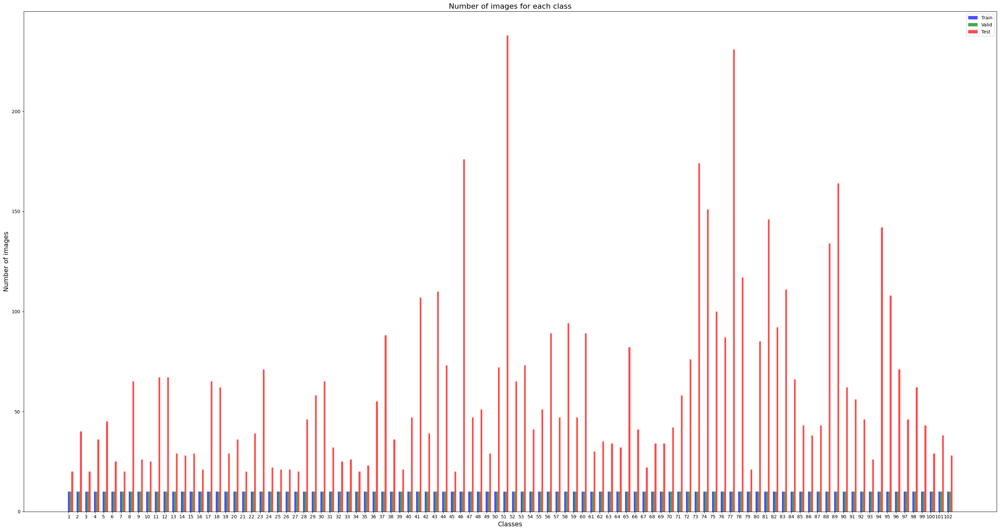

In [12]:
def count_images_in_folder(folder_path):
    count = 0
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.endswith(('.jpg', '.jpeg', '.png')):
                count += 1
    return count

def plot_histogram(train_folder, valid_folder, test_folder):
    train_counts = []
    valid_counts = []
    test_counts = []
    labels = []

    subfolders = [d for d in os.listdir(train_folder) if os.path.isdir(os.path.join(train_folder, d))]

    for subfolder in subfolders:
        train_counts.append(count_images_in_folder(os.path.join(train_folder, subfolder)))
        valid_counts.append(count_images_in_folder(os.path.join(valid_folder, subfolder)))
        test_counts.append(count_images_in_folder(os.path.join(test_folder, subfolder)))
        labels.append(subfolder)

    sorted_data = sorted(zip(map(int, labels), train_counts, valid_counts, test_counts))

    sorted_labels, sorted_train_counts, sorted_valid_counts, sorted_test_counts = zip(*sorted_data)

    bar_width = 0.2
    index = range(len(labels))
    opacity = 0.7

    fig, ax = plt.subplots(figsize=(30, 16))

    plt.bar(index, sorted_train_counts, bar_width, alpha=opacity, color='b', label='Train')
    plt.bar([i + bar_width for i in index], sorted_valid_counts, bar_width, alpha=opacity, color='g', label='Valid')
    plt.bar([i + 2 * bar_width for i in index], sorted_test_counts, bar_width, alpha=opacity, color='r', label='Test')

    plt.xlabel('Classes', fontsize=14)
    plt.ylabel('Number of images', fontsize=14)
    plt.title('Number of images for each class', fontsize=16)
    plt.xticks(index, sorted_labels)
    plt.legend()

    plt.tight_layout()
    plt.show()

train_folder = train_data_dir
valid_folder = val_data_dir
test_folder = test_data_dir

plot_histogram(train_folder, valid_folder, test_folder)

Image visualization with name labels

In [22]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import cv2

def print_images_by_class_subplot(csv_file, image_folder, rows, cols):
    
    df = pd.read_csv(csv_file)
    class_name_to_number = {row['class_name']: row['class'] for index, row in df.iterrows()}

    fig, axs = plt.subplots(rows, cols, figsize=(100, 100))

    for i, (class_name, class_number) in enumerate(class_name_to_number.items()):

        class_folder = os.path.join(image_folder, str(class_number))
        image_files = os.listdir(class_folder)
        image_path = os.path.join(class_folder, image_files[0])  
        image = cv2.imread(image_path)
        axs[i // cols, i % cols].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axs[i // cols, i % cols].set_title(class_name, fontsize=40)
        axs[i // cols, i % cols].axis('off')

    plt.show()

num_rows = 17
num_cols = 6

print_images_by_class_subplot("/kaggle/input/aml-flowers-dataset/new_classes_train.csv", train_folder, num_rows, num_cols)
